In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set()
from sklearn.model_selection import learning_curve
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.metrics import precision_recall_fscore_support as prfs
from sklearn.metrics import plot_roc_curve
from sklearn.model_selection import cross_validate
from sklearn.preprocessing import LabelBinarizer

In [2]:
from sklearn.metrics import confusion_matrix
plt.style.use('ggplot')
np.set_printoptions(suppress=True) # Suppress scientific notation where possible
pd.options.display.float_format = '{:.0f}'.format

In [3]:
import plotly.offline as off
off.init_notebook_mode(connected=False) # allows for offline mode
import plotly.figure_factory as ff
import plotly.graph_objs as go

In [4]:
import xgboost as xgb
sns.set_style("whitegrid")
from sklearn.ensemble import GradientBoostingClassifier

In [5]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.tree import plot_tree

In [6]:
import os
from os import listdir
from os.path import isfile, join

In [7]:
from sklearn.linear_model import LogisticRegressionCV

In [8]:
import json

In [9]:
pd.set_option('precision',1)

In [10]:
adf = pd.read_csv('eons/world_arch.tsv',sep='\t')
prdf = pd.read_csv('eons/world_prot.tsv',sep='\t')

In [11]:
path = 'eons/phanerozoic'
phan_files = [f for f in listdir(path) if isfile(join(path, f))]

In [12]:
phan_list = []
for file in phan_files:
    phan_list.append(pd.read_csv(join(path,file),sep='\t'))
phdf = pd.concat(phan_list,ignore_index=True)

In [13]:
adf['EON'] = pd.Series(['ARCHEAN' for line in range(len(adf.index))], index=adf.index)

In [14]:
prdf['EON'] = pd.Series(['PROTEROZOIC' for line in range(len(prdf.index))], index=prdf.index)
phdf['EON'] = pd.Series(['PHANEROZOIC' for line in range(len(phdf.index))], index=phdf.index)

In [15]:
df = pd.concat([adf,prdf,phdf],ignore_index=True)

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 182467 entries, 0 to 182466
Data columns (total 57 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   SAMPLE ID    182465 non-null  object 
 1   IGSN         5 non-null       object 
 2   SOURCE       182467 non-null  object 
 3   REFERENCE    182467 non-null  object 
 4   CRUISE ID    4144 non-null    object 
 5   LATITUDE     182466 non-null  float64
 6   LONGITUDE    182466 non-null  float64
 7   LOC PREC     179509 non-null  float64
 8   MIN AGE      180027 non-null  float64
 9   AGE          182467 non-null  float64
 10  MAX AGE      180027 non-null  float64
 11  MATERIAL     182467 non-null  object 
 12  TYPE         182467 non-null  object 
 13  COMPOSITION  179517 non-null  object 
 14  ROCK NAME    180248 non-null  object 
 15  MINERAL      1 non-null       object 
 16  SIO2         182467 non-null  float64
 17  TIO2         182350 non-null  object 
 18  AL2O3        182462 non-

In [17]:
major_df = df[(df['SIO2'] > 40.0) & (df['SIO2'] < 80.0)]

In [18]:
oxide_list = ['SIO2','TIO2','AL2O3','FEOT','MNO','MGO','CAO','NA2O','K2O','P2O5']

In [19]:
major_only = major_df[['EON','SIO2','TIO2','AL2O3','FEOT','MNO',
                      'MGO','CAO','NA2O','K2O','P2O5',
                      'TYPE','COMPOSITION','ROCK NAME']].copy()

In [20]:
for col in oxide_list:
    major_only[col] = pd.to_numeric(major_only[col],errors='coerce')

In [21]:
major_only.fillna(value=0.0,inplace=True)

In [22]:
X_train,X_test,y_train,y_test = train_test_split(
    major_only.drop(['EON','TYPE','COMPOSITION','ROCK NAME'],axis=1)
                                                 ,major_only['EON'])

In [22]:
major_tree = DecisionTreeClassifier(max_depth=10)
major_tree.fit(X_train,y_train)
print("Train: ",major_tree.score(X_train,y_train)," Test: ",
      major_tree.score(X_test,y_test))

Train:  0.9362440628425284  Test:  0.9256855996667909


In [23]:
major_tree.classes_

array(['ARCHEAN', 'PHANEROZOIC', 'PROTEROZOIC'], dtype=object)

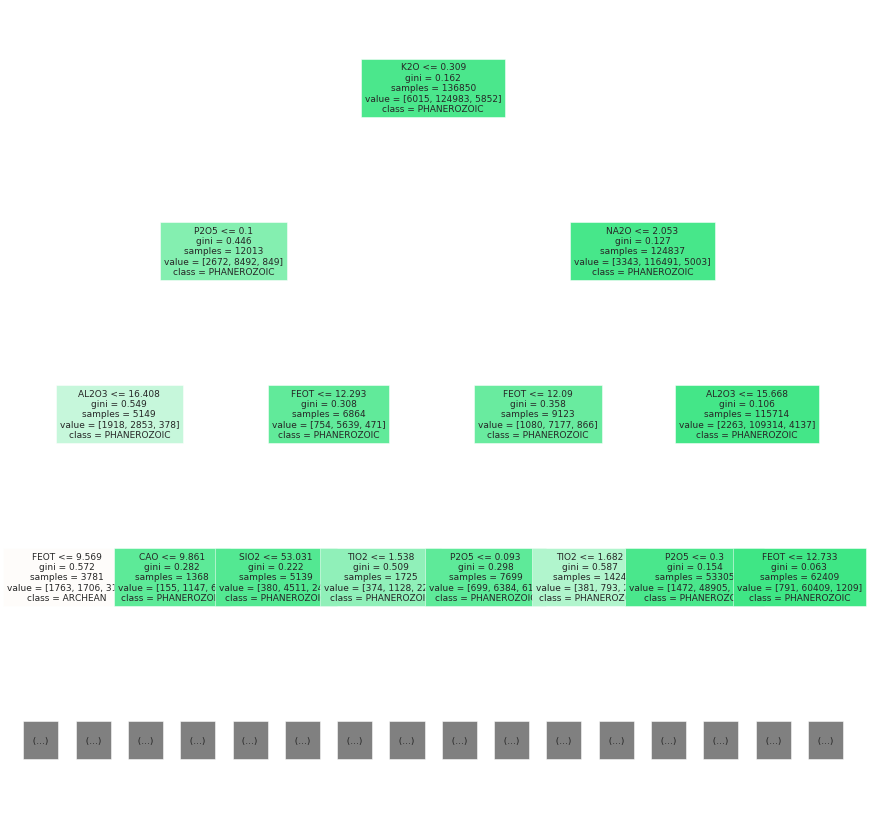

In [24]:
plt.subplots(figsize=(15, 15))
plot_tree(major_tree,feature_names=oxide_list,class_names=list(major_tree.classes_),
         filled=True,rotate=True,max_depth=3,fontsize=9)
plt.show();

In [25]:
major_tree = DecisionTreeClassifier(max_depth=5)
major_tree.fit(X_train,y_train)
print("Train: ",major_tree.score(X_train,y_train)," Test: ",
      major_tree.score(X_test,y_test))

Train:  0.9207599561563756  Test:  0.9222658219523423


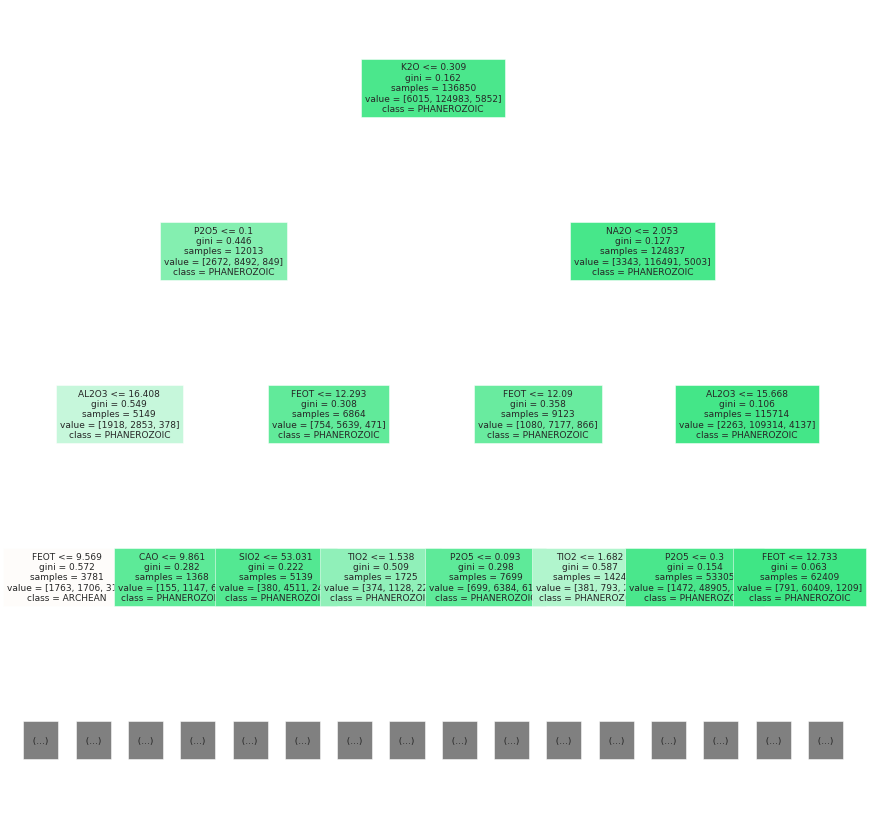

In [26]:
plt.subplots(figsize=(15, 15))
plot_tree(major_tree,feature_names=oxide_list,class_names=list(major_tree.classes_),
         filled=True,rotate=True,max_depth=3,fontsize=9)
plt.show();

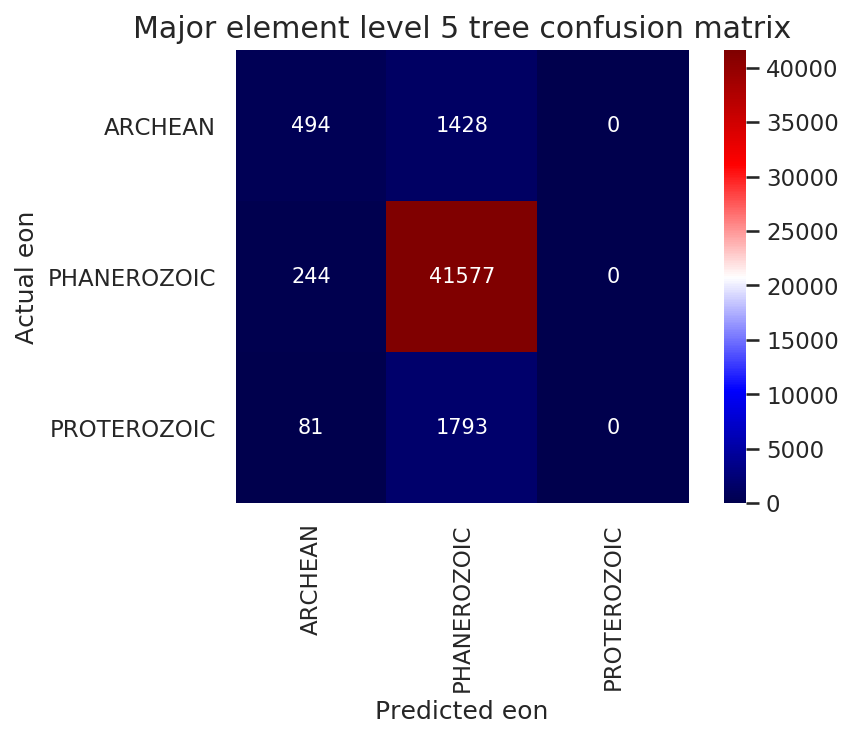

In [27]:
major_tree_confusion = confusion_matrix(y_test, major_tree.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(major_tree_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=major_tree.classes_,
           yticklabels=major_tree.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major element level 5 tree confusion matrix');

In [28]:
prfs(y_test, major_tree.predict(X_test))

/home/paulus/anaconda3/lib/python3.7/site-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



(array([0.6031746 , 0.92809947, 0.        ]),
 array([0.25702393, 0.99416561, 0.        ]),
 array([0.36045239, 0.95999723, 0.        ]),
 array([ 1922, 41821,  1874]))

The recall and F1 for the Precambrian are phenomenally bad in 1) this simple decision tree classifier and 2) this now very imbalanced dataset with 7000-8000 each of Archean & Proterozoic samples in an overall stew of >180000 samples.

At this point I will try a logistic regression with an L1 / lasso feature eliminator to see what that suggests is most / least important.

In [23]:
major_full = major_df[['EON','LATITUDE','LONGITUDE','AGE','SIO2','TIO2','AL2O3',
                      'FEOT','MNO','MGO','CAO','NA2O','K2O','P2O5','TYPE','COMPOSITION',
                      'ROCK NAME']].copy()
for col in (oxide_list + ['LATITUDE','LONGITUDE','AGE']):
    major_full[col] = pd.to_numeric(major_full[col],errors='coerce')
major_full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 182467 entries, 0 to 182466
Data columns (total 17 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   EON          182467 non-null  object 
 1   LATITUDE     182466 non-null  float64
 2   LONGITUDE    182466 non-null  float64
 3   AGE          182467 non-null  float64
 4   SIO2         182467 non-null  float64
 5   TIO2         182340 non-null  float64
 6   AL2O3        182462 non-null  float64
 7   FEOT         182441 non-null  float64
 8   MNO          176690 non-null  float64
 9   MGO          181074 non-null  float64
 10  CAO          182329 non-null  float64
 11  NA2O         182221 non-null  float64
 12  K2O          182105 non-null  float64
 13  P2O5         172787 non-null  float64
 14  TYPE         182467 non-null  object 
 15  COMPOSITION  179517 non-null  object 
 16  ROCK NAME    180248 non-null  object 
dtypes: float64(13), object(4)
memory usage: 25.1+ MB


In [24]:
rat_df = pd.concat([major_full['MGO']/(major_full['MGO']+major_full['FEOT'])*100,
                      major_full['CAO']/(major_full['NA2O']+major_full['K2O']),
                      major_full['SIO2']/major_full['AL2O3'],
                      major_full['SIO2']/major_full['TIO2']],axis=1)
rat_df.columns = ['Mg#','Ca/Alk','Si/Al','Si/Ti']

In [25]:
major_full = pd.concat([major_full,rat_df],axis=1)
major_full.replace(to_replace=np.inf,value=np.nan,inplace=True)
major_full.dropna(inplace=True)
major_full.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 165423 entries, 1 to 182466
Data columns (total 21 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   EON          165423 non-null  object 
 1   LATITUDE     165423 non-null  float64
 2   LONGITUDE    165423 non-null  float64
 3   AGE          165423 non-null  float64
 4   SIO2         165423 non-null  float64
 5   TIO2         165423 non-null  float64
 6   AL2O3        165423 non-null  float64
 7   FEOT         165423 non-null  float64
 8   MNO          165423 non-null  float64
 9   MGO          165423 non-null  float64
 10  CAO          165423 non-null  float64
 11  NA2O         165423 non-null  float64
 12  K2O          165423 non-null  float64
 13  P2O5         165423 non-null  float64
 14  TYPE         165423 non-null  object 
 15  COMPOSITION  165423 non-null  object 
 16  ROCK NAME    165423 non-null  object 
 17  Mg#          165423 non-null  float64
 18  Ca/Alk       165423 non-

In [26]:
scaler = MinMaxScaler()
data_list = oxide_list + ['LATITUDE','LONGITUDE','Mg#','Ca/Alk','Si/Al','Si/Ti']
X = major_full[data_list]
y = major_full['EON']
X_tr,X_tst,y_train,y_test = train_test_split(X,y)
X_train = scaler.fit_transform(X_tr)
X_test = scaler.transform(X_tst)

In [35]:
grand_loge = LogisticRegressionCV(penalty='l1',solver='saga',tol=5e-3,
                                  max_iter=1000,n_jobs=3)


Train:  0.9192533066810675  Test:  0.9202050488441822


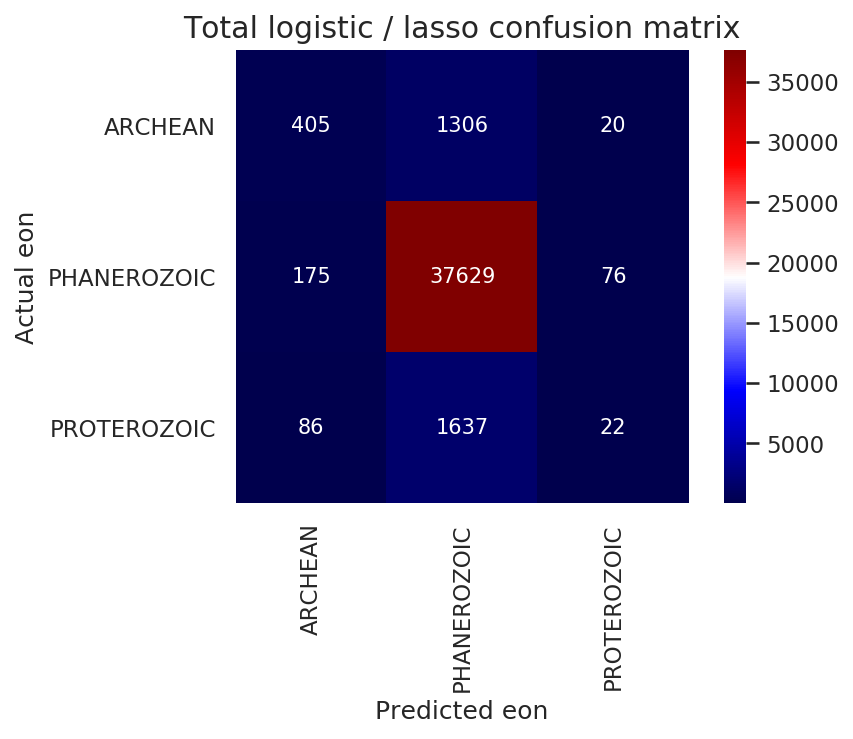

In [36]:
grand_loge.fit(X_train,y_train)
print("\nTrain: ",grand_loge.score(X_train,y_train)," Test: ",
      grand_loge.score(X_test,y_test))
grand_loge_confusion = confusion_matrix(y_test, grand_loge.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(grand_loge_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=grand_loge.classes_,
           yticklabels=grand_loge.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Total logistic / lasso confusion matrix');

In [45]:
grand_loge.coef_[2][4]

-0.6002557691637265

In [48]:
loge_feature_dict = {}
for i, feature in enumerate(X.columns):
    loge_feature_dict[feature]=[grand_loge.coef_[0][i],grand_loge.coef_[2][i],
                               grand_loge.coef_[1][i]]
print("Archean, Proterozoic, Phanerozoic")
loge_feature_dict

Archean, Proterozoic, Phanerozoic


{'SIO2': [4.094132141375559, -0.19666491448525172, -5.971255455134034],
 'TIO2': [-33.093035735038164, 0.3831991613885906, 13.102213745120363],
 'AL2O3': [-0.03880224998143502, -0.07789810704972584, 2.3485914978818925],
 'FEOT': [8.661077427518471, -0.1693474184380621, -26.075259523092907],
 'MNO': [6.012062061879838, -0.6002557691637265, -0.059025135521177136],
 'MGO': [-0.5227467919807428, 1.9137984389278242, -0.044849402753550476],
 'CAO': [3.324706502721834, -0.1834503760733565, 0.015543152217221684],
 'NA2O': [-0.8072890170175172, 0.03992641239807128, 0.03328494432364019],
 'K2O': [-6.782654533566353, 4.520483893739378, -0.07521801876931979],
 'P2O5': [-7.4713100100477865, -0.5646618597834393, 31.067308700054717],
 'LATITUDE': [-0.03078886814517352, -0.2813878925176902, 0.13385294851445675],
 'LONGITUDE': [0.01871863010944539, 0.7386897459949197, -0.754159267441336],
 'Mg#': [3.202552737328651, -0.013189313835669299, -0.7787958017068255],
 'Ca/Alk': [7.999841361130662, -0.67244456

Wuhl crap. That didn't eliminate anything. 'Course as shitty as that confusion matrix is I have no idea why I'd trust it.

In [49]:
rfc = RandomForestClassifier()
rfc.fit(X_tr,y_train)
rfc.score(X_tr,y_train)

0.9998790975843698

HFS. The recall can only be so shitty for a score that high.

In [50]:
rfc.score(X_tst,y_test)

0.9801238030757327

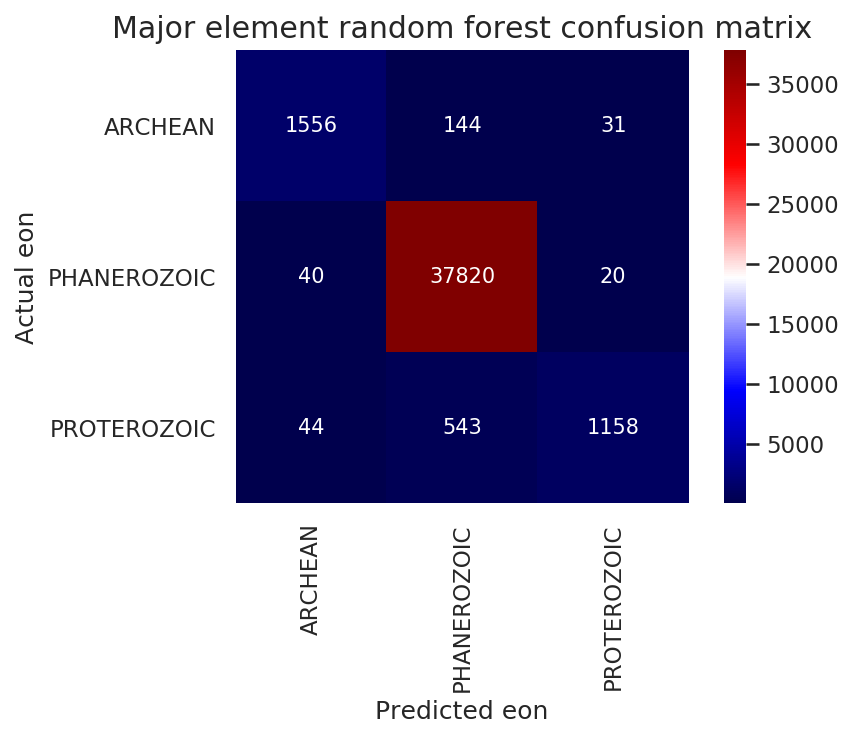

In [52]:
rfc_confusion = confusion_matrix(y_test, rfc.predict(X_tst))
plt.figure(dpi=100)
sns.heatmap(rfc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=rfc.classes_,
           yticklabels=rfc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major element random forest confusion matrix');

In [53]:
prfs(y_test, rfc.predict(X_tst))

(array([0.94878049, 0.98215909, 0.95781638]),
 array([0.89890237, 0.99841605, 0.66361032]),
 array([0.9231682 , 0.99022085, 0.78402167]),
 array([ 1731, 37880,  1745]))

In [54]:
dict(zip(X.columns,rfc.feature_importances_))

{'SIO2': 0.03454087829320026,
 'TIO2': 0.04243309356627181,
 'AL2O3': 0.038285665435828044,
 'FEOT': 0.06119959390333426,
 'MNO': 0.03187330894732957,
 'MGO': 0.03281470556732317,
 'CAO': 0.030808977711430586,
 'NA2O': 0.04366812759608027,
 'K2O': 0.057341534684181426,
 'P2O5': 0.05618341641584306,
 'LATITUDE': 0.194739252793716,
 'LONGITUDE': 0.2226660309797453,
 'Mg#': 0.03593899911590889,
 'Ca/Alk': 0.03354744302284075,
 'Si/Al': 0.03634859739509209,
 'Si/Ti': 0.04761037457187429}

Train:  0.9668163169900135  Test:  0.9663893993616404
(array([0.94110429, 0.96898965, 0.89746544]), array([0.85269594, 0.99772119, 0.42849285]), array([0.89472149, 0.98314555, 0.58004468]), array([ 1799, 37739,  1818]))
{'SIO2': 0.00472022191696655, 'TIO2': 0.00534205417767453, 'AL2O3': 0.005369278101945157, 'FEOT': 0.05699846037173278, 'MNO': 0.0010591301049478624, 'MGO': 0.0017048068815067661, 'CAO': 0.002951561226749232, 'NA2O': 0.01930544614191034, 'K2O': 0.034443709065456754, 'P2O5': 0.04156575595999949, 'LATITUDE': 0.34837748896230114, 'LONGITUDE': 0.43990170884261975, 'Mg#': 0.0028695201383827484, 'Ca/Alk': 0.0013809071560111842, 'Si/Al': 0.013407809438199593, 'Si/Ti': 0.02060214151359631}


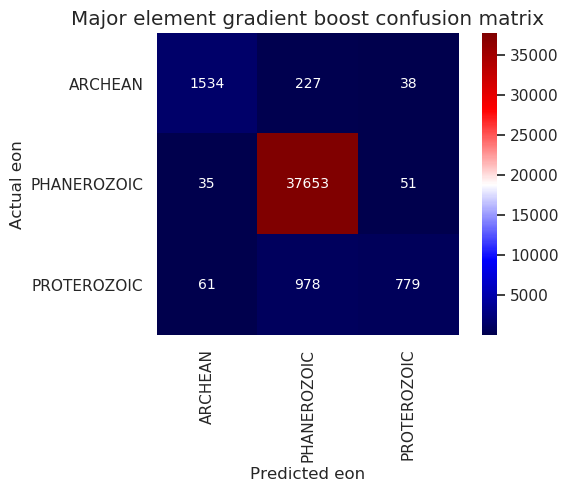

In [87]:
gbf = GradientBoostingClassifier()
gbf.fit(X_tr,y_train)
print('Train: ',gbf.score(X_tr,y_train),' Test: ', gbf.score(X_tst,y_test))
print(prfs(y_test, gbf.predict(X_tst)))
print(dict(zip(X.columns,gbf.feature_importances_)))
gbf_confusion = confusion_matrix(y_test, gbf.predict(X_tst))
plt.figure(dpi=100)
sns.heatmap(gbf_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=gbf.classes_,
           yticklabels=gbf.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major element gradient boost confusion matrix');

In [61]:
# Drop the geographical data. That's cheating.
# npt = no place training, npv = no place validation

X_npt = X_tr.drop(['LATITUDE','LONGITUDE'],axis=1)
X_npv = X_tst.drop(['LATITUDE','LONGITUDE'],axis=1)

Train:  0.9996131122699832  Test:  0.9392591159686623
(array([0.78984238, 0.9447293 , 0.82943925]), array([0.50138966, 0.99597234, 0.19526953]), array([0.6133968 , 0.9696743 , 0.31611754]), array([ 1799, 37739,  1818]))
{'SIO2': 0.06407849015734843, 'TIO2': 0.06878835889631588, 'AL2O3': 0.07082993218360255, 'FEOT': 0.10163605772136987, 'MNO': 0.06067077095119534, 'MGO': 0.06226096313358982, 'CAO': 0.060495341712118164, 'NA2O': 0.07794244278476276, 'K2O': 0.0851680766610411, 'P2O5': 0.08849655261427421, 'LATITUDE': 0.0626178659600065, 'LONGITUDE': 0.06298680713636975, 'Mg#': 0.06302454317903264, 'Ca/Alk': 0.07100379690897303}


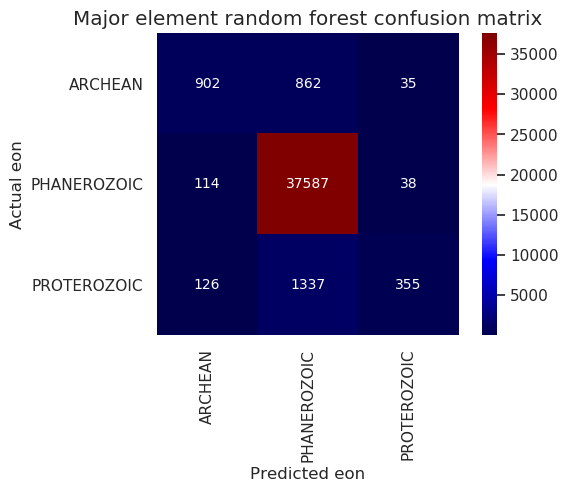

In [63]:
rfc_np = RandomForestClassifier()
rfc_np.fit(X_npt,y_train)
print('Train: ',rfc_np.score(X_npt,y_train),' Test: ', rfc_np.score(X_npv,y_test))
print(prfs(y_test, rfc_np.predict(X_npv)))
print(dict(zip(X_npt.columns,rfc_np.feature_importances_)))
rfc_np_confusion = confusion_matrix(y_test, rfc_np.predict(X_npv))
plt.figure(dpi=100)
sns.heatmap(rfc_np_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=rfc_np.classes_,
           yticklabels=rfc_np.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major element random forest confusion matrix');

Train:  0.9297315160356904  Test:  0.9258390560015476
(array([0.687251  , 0.93311444, 0.5704698 ]), array([0.38354641, 0.994038  , 0.04675468]), array([0.49232965, 0.96261323, 0.08642603]), array([ 1799, 37739,  1818]))
{'SIO2': 0.03186818344252145, 'TIO2': 0.02574794002688276, 'AL2O3': 0.06717047702831454, 'FEOT': 0.3133648504429682, 'MNO': 0.018408740390875086, 'MGO': 0.015357694548292613, 'CAO': 0.01871821671126953, 'NA2O': 0.0791866593814167, 'K2O': 0.13826220934907543, 'P2O5': 0.13740623002770103, 'Mg#': 0.02749856373328266, 'Ca/Alk': 0.013975094855821144, 'Si/Al': 0.037016627852703196, 'Si/Ti': 0.07601851220887558}


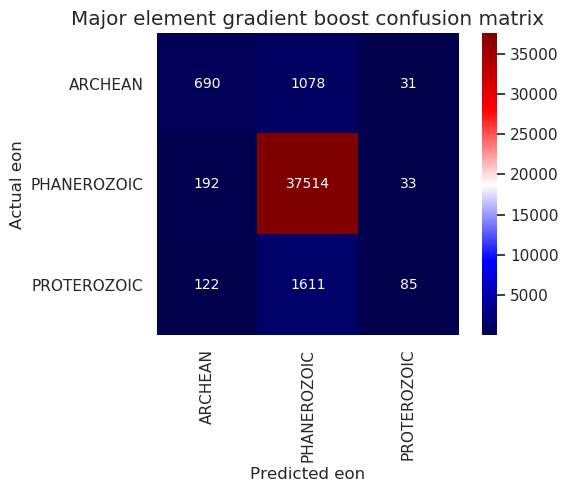

In [88]:
gbf_np = GradientBoostingClassifier()
gbf_np.fit(X_npt,y_train)
print('Train: ',gbf_np.score(X_npt,y_train),' Test: ', gbf_np.score(X_npv,y_test))
print(prfs(y_test, gbf_np.predict(X_npv)))
print(dict(zip(X_npt.columns,gbf_np.feature_importances_)))
gbf_np_confusion = confusion_matrix(y_test, gbf_np.predict(X_npv))
plt.figure(dpi=100)
sns.heatmap(gbf_np_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=gbf_np.classes_,
           yticklabels=gbf_np.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major element gradient boost confusion matrix');

Reminder to use probability scores from forest classifiers to adjust precision & recall. I can make a Precambrian ROC curve from a three-eon classifier, although it might be easier to retrain a "coded" Precambrian classifier. Almost certainly is.

Good practical and theoretic reasons to do an Archean vs. the world classifier instead, actually.

In [ ]:
def make_confusion_matrix(model,title, threshold,x_val,y_val):
    # Predict class 1 if probability of being in class 1 is greater than threshold
    # (model.predict(X_test) does this automatically with a threshold of 0.5)
    y_predict = (model.predict_proba(x_val)[:, 1] >= threshold)
    fraud_confusion = confusion_matrix(y_val, y_predict)
    plt.figure(dpi=80)
    sns.heatmap(fraud_confusion, cmap=plt.cm.Blues, annot=True, square=True, fmt='d',
           xticklabels=['$', 'Not $'],
           yticklabels=['$', 'Not $']).set_title('{}'.format(title));
    plt.xlabel('prediction')
    plt.ylabel('actual')

Let's get some plotly up in here.

Let's do a TAS diagram. In case this text winds up in front of ye instructors or TAs, a TAS diagram is a standard plot used to name igneous rocks in these latter days. It's SiO2 on the x-axis versus "total alkalis" = Na2O + K2O on the y-axis, like so: https://www.researchgate.net/profile/Stefan_Marincea/publication/259331690/figure/fig5/AS:297105957638149@1447846988245/TAS-diagram-Le-Maitre-1989-of-magmatic-rocks-from-the-ECSZ-Legend-of-symbols_W640.jpg

Oooh. I wonder how hard it would be to yank the boundary lines between different rock types and have plotly tell you what the rock type is when you hover over it. A tooltip saying "phonolite" would be HOT. No, you don't understand.

Oh, that's right, there are carbonatites in this dataset down at stupid, stupid low SiO2. There are some phenomenally alkalic rocks in there too (compare to the figure I linked above).

Probably would be interesting to see these break down by eon.

In [27]:
arch_sample = major_only[major_only['EON']=='ARCHEAN'].sample(500)
# Archean
archean = go.Scatter(
    x = arch_sample['SIO2'],
    y = arch_sample['NA2O']+ arch_sample['K2O'],
    name = 'Archean',
    mode = 'markers',
    marker = dict(
        size=5,
        color='red',
        opacity=0.5,
        line=dict(width=1)
    ),
#    hovertemplate = '<i>%{name}</i>',
)

prot_sample = major_only[major_only['EON']=='PROTEROZOIC'].sample(500)
# Proterozoic
protero = go.Scatter(
    x = prot_sample['SIO2'],
    y = prot_sample['NA2O']+ prot_sample['K2O'],
    name = 'Proterozoic',
    mode = 'markers',
    marker = dict(
        size=5,
        color='green',
        opacity=0.5,
        line=dict(width=1)
    ),
#    hovertemplate = '<i>%{name}</i>',
)

# Phanerozoic
phan_sample = major_only[major_only['EON']=='PHANEROZOIC'].sample(500)
phanero = go.Scatter(
    x = phan_sample['SIO2'],
    y = phan_sample['NA2O']+ phan_sample['K2O'],
    name = 'Phanerozoic',
    mode = 'markers',
    marker = dict(
        size=5,
        color='blue',
        opacity=0.5,
        line=dict(width=1)
    ),
#    hovertemplate = '<i>%{name}</i>',
)

data=[phanero, protero, archean]

# Modify layout
layout = dict(
    title = 'TAS plot by geologic eon for EarthChem data',
    xaxis = dict(
        title = 'SiO2, wt%',
        zeroline = False
    ),
    yaxis = dict(
        title = 'Na2O + K2O, wt%',
        hoverformat = '.1f'
    ),
    hovermode= 'closest'  #Point 3. Include to activate tooltip for closest datapoint.
)

off.iplot(dict(data=data, layout=layout))

In [75]:
trace0 = go.Scatter3d(
    x = arch_sample['P2O5'],
    y = arch_sample['K2O'],
    z = arch_sample['FEOT'],
    name = 'Archean',
    mode = 'markers',
    marker = dict(
        size=1,
        color='red',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace1 = go.Scatter3d(
    x = prot_sample['P2O5'],
    y = prot_sample['K2O'],
    z = prot_sample['FEOT'],
    name = 'Proterozoic',
    mode = 'markers',
    marker = dict(
        size=1,
        color='green',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace2 = go.Scatter3d(
    x = phan_sample['P2O5'],
    y = phan_sample['K2O'],
    z = phan_sample['FEOT'],
    name = 'Phanerozoic',
    mode = 'markers',
    marker = dict(
        size=1,
        color='blue',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

data=[trace0, trace1, trace2]

# Modify layout
layout = go.Layout(
    title = 'Major element chemistry by eon, S. Afr. igneous',
    scene =
      dict(
          xaxis = dict(
              title = 'P2O5',
              zeroline = True
          ),
          yaxis = dict(
              title = 'K2O',
              zeroline = True
          ),
          zaxis = dict(
              title = 'FeO (total)',
              zeroline = True
          ),
          hovermode= 'closest'
      )
)

off.iplot(dict(data=data, layout=layout))

In [86]:
# Desperate attempt at a map with data points
safr_adf = pd.read_csv('eons/safr_archean.tsv',sep='\t')
safr_prdf = pd.read_csv('eons/safr_proterozoic.tsv',sep='\t')
safr_phdf = pd.read_csv('eons/safr_phanerozoic.tsv',sep='\t')

saf_arch = go.Scattergeo(
    lat=safr_adf['LATITUDE'],
    lon=safr_adf['LONGITUDE'],
    name='Archean',
    marker={
        'size': 8,
        'color': 'Red'
    }
)
saf_prot = go.Scattergeo(
    lat=safr_prdf['LATITUDE'],
    lon=safr_prdf['LONGITUDE'],
    name='Proterozoic',
    marker={
        'size': 8,
        'color': 'Green'
    }
)
saf_phan = go.Scattergeo(
    lat=safr_phdf['LATITUDE'],
    lon=safr_phdf['LONGITUDE'],
    name='Phanerozoic',
    marker={
        'size': 8,
        'color': 'Blue'
    }
)

fig = go.Figure([saf_arch,saf_prot,saf_phan])
fig.update_geos(
    resolution=50,
    showcoastlines=True, coastlinecolor="Black",
    showland=True, landcolor="LightGray",
    showocean=True, oceancolor="LightBlue",
    showlakes=True, lakecolor="Blue",
    showrivers=True, rivercolor="Blue",
    showcountries=True, countrycolor="Brown",
    fitbounds="locations"
)
fig.update_layout(height=300, margin={"r":0,"t":0,"l":0,"b":0})

fig.show()

So apparently I can't do ROC curves on three-way classifications. I need a positive and a negative. Right. Do I cut out Archean vs. Cold Earth or Phanerozoic vs. Precambrian? I want the biggest difference in bin size, and Phanerozoic is a tad smaller than Archean in the S. African data, so there we go.

Actually, the right choice is to do both, isn't it? I could also split out Proterozoic... but I don't have THAT much time.

In [32]:
def code_phan(eon):
    if eon == 'PHANEROZOIC':
        return 1
    else:
        return 0
    
def code_arch(eon):
    if eon == 'ARCHEAN':
        return 1
    else:
        return 0

In [33]:
major_only['CODEP']=major_only['EON'].map(code_phan)

In [34]:
major_only['CODEA']=major_only['EON'].map(code_arch)

As curious as I am about SVC, I'll do it regardless of the fact that its score is so low.

In [35]:
X_train,X_test,y_train,y_test = train_test_split(
    major_only.drop(['EON','TYPE','COMPOSITION','ROCK NAME','CODEA','CODEP'],axis=1),
    major_only['CODEA'])

In [36]:
svc_arch=SVC(kernel='linear')
svc_arch.fit(X_train,y_train)
print("Train score: ",svc_arch.score(X_train,y_train))
print("Test score: ",svc_arch.score(X_test,y_test))

Train score:  0.7730886850152905
Test score:  0.7926605504587156


In [37]:
rfc_arch=RandomForestClassifier()
rfc_arch.fit(X_train,y_train)
print("Train score: ",rfc_arch.score(X_train,y_train))
print("Test score: ",rfc_arch.score(X_test,y_test))

Train score:  1.0
Test score:  0.9522935779816514


In [38]:
gbf_arch=GradientBoostingClassifier()
gbf_arch.fit(X_train,y_train)
print("Train score: ",gbf_arch.score(X_train,y_train))
print("Test score: ",gbf_arch.score(X_test,y_test))

Train score:  0.964525993883792
Test score:  0.9412844036697248


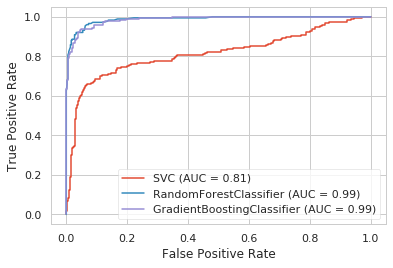

In [39]:
ax = plt.gca()
svc_plot = plot_roc_curve(svc_arch,X_test,y_test,ax=ax)
rfc_plot = plot_roc_curve(rfc_arch,X_test,y_test,ax=ax)
gbf_plot = plot_roc_curve(gbf_arch,X_test,y_test,ax=ax)
plt.show()

In [40]:
X_train,X_test,y_train,y_test = train_test_split(
    major_only.drop(['EON','TYPE','COMPOSITION','ROCK NAME','CODEA','CODEP'],axis=1),
    major_only['CODEP'])

In [41]:
svc_phan=SVC(kernel='linear')
svc_phan.fit(X_train,y_train)
print("Train score: ",svc_phan.score(X_train,y_train))
print("Test score: ",svc_phan.score(X_test,y_test))

Train score:  0.8366972477064221
Test score:  0.8165137614678899


In [42]:
rfc_phan=RandomForestClassifier()
rfc_phan.fit(X_train,y_train)
print("Train score: ",rfc_phan.score(X_train,y_train))
print("Test score: ",rfc_phan.score(X_test,y_test))

Train score:  1.0
Test score:  0.9302752293577982


In [43]:
gbf_phan=GradientBoostingClassifier()
gbf_phan.fit(X_train,y_train)
print("Train score: ",gbf_phan.score(X_train,y_train))
print("Test score: ",gbf_phan.score(X_test,y_test))

Train score:  0.9700305810397554
Test score:  0.9119266055045872


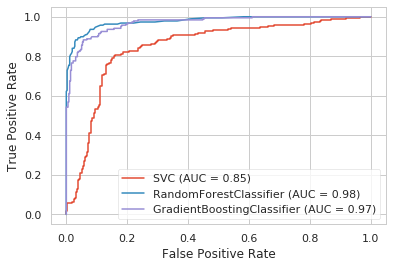

In [44]:
ax = plt.gca()
svc_plot = plot_roc_curve(svc_phan,X_test,y_test,ax=ax)
rfc_plot = plot_roc_curve(rfc_phan,X_test,y_test,ax=ax)
gbf_plot = plot_roc_curve(gbf_phan,X_test,y_test,ax=ax)
plt.show()

Let's check cross-validation.

In [45]:
X = major_only.drop(['EON','TYPE','COMPOSITION','ROCK NAME','CODEA','CODEP'],axis=1)
yo = major_only['EON']

In [46]:
svc_cross = SVC(kernel='linear')
svc_scores = cross_val_score(svc_cross,X,yo)
print("\nMean SVC score: ",np.mean(svc_scores))
print("Individual scores: ",svc_scores)

rfc_cross = RandomForestClassifier()
rfc_scores = cross_val_score(rfc_cross,X,yo)
print("\nMean random forest regression score: ",np.mean(rfc_scores))
print("Individual scores: ",rfc_scores)

gbf_cross = GradientBoostingClassifier()
gbf_scores = cross_val_score(gbf_cross,X,yo)
print("\nMean gradient boosted regression score: ",np.mean(gbf_scores))
print("Individual scores: ",gbf_scores)


Mean SVC score:  0.6995412844036697
Individual scores:  [0.58256881 0.71330275 0.79587156 0.71559633 0.69036697]

Mean random forest regression score:  0.8389908256880734
Individual scores:  [0.7293578  0.77522936 0.97018349 0.92201835 0.79816514]

Mean gradient boosted regression score:  0.8243119266055045
Individual scores:  [0.71788991 0.76146789 0.94954128 0.91513761 0.77752294]


In [47]:
yo=major_only['CODEA']

In [49]:
svc_cross = SVC(kernel='linear')
svc_scores = cross_val_score(svc_cross,X,yo)
print("\nMean SVC score: ",np.mean(svc_scores))
print("Individual scores: ",svc_scores)

rfc_cross = RandomForestClassifier()
rfc_scores = cross_val_score(rfc_cross,X,yo)
print("\nMean random forest regression score: ",np.mean(rfc_scores))
print("Individual scores: ",rfc_scores)

gbf_cross = GradientBoostingClassifier()
gbf_scores = cross_val_score(gbf_cross,X,yo)
print("\nMean gradient boosted regression score: ",np.mean(gbf_scores))
print("Individual scores: ",gbf_scores)


Mean SVC score:  0.7522935779816514
Individual scores:  [0.77752294 0.81192661 0.67201835 0.74311927 0.75688073]

Mean random forest regression score:  0.8954128440366972
Individual scores:  [0.88761468 0.93119266 0.89220183 0.90825688 0.85779817]

Mean gradient boosted regression score:  0.886697247706422
Individual scores:  [0.88761468 0.90825688 0.88761468 0.89220183 0.85779817]


In [50]:
yo = major_only['CODEP']

In [51]:
svc_cross = SVC(kernel='linear')
svc_scores = cross_val_score(svc_cross,X,yo)
print("\nMean SVC score: ",np.mean(svc_scores))
print("Individual scores: ",svc_scores)

rfc_cross = RandomForestClassifier()
rfc_scores = cross_val_score(rfc_cross,X,yo)
print("\nMean random forest regression score: ",np.mean(rfc_scores))
print("Individual scores: ",rfc_scores)

gbf_cross = GradientBoostingClassifier()
gbf_scores = cross_val_score(gbf_cross,X,yo)
print("\nMean gradient boosted regression score: ",np.mean(gbf_scores))
print("Individual scores: ",gbf_scores)


Mean SVC score:  0.7954128440366972
Individual scores:  [0.6766055  0.77293578 0.82110092 0.8853211  0.82110092]

Mean random forest regression score:  0.8788990825688074
Individual scores:  [0.80963303 0.86009174 0.91743119 0.97018349 0.83715596]

Mean gradient boosted regression score:  0.8697247706422019
Individual scores:  [0.79357798 0.81651376 0.92201835 0.96330275 0.85321101]


Well. Now it's time to get under the hood and see which of the major element features are being used to push data into different bins.

In [52]:
X_train,X_test,y_train,y_test = train_test_split(
    major_only.drop(['EON','TYPE','COMPOSITION','ROCK NAME','CODEA','CODEP'],axis=1),
    major_only['EON'])

In [53]:
svc_major = SVC(kernel='linear')
svc_major.fit(X_train,y_train)
print("Train: ",svc_major.score(X_train,y_train)," Test: ",
      svc_major.score(X_test,y_test))

Train:  0.7437308868501529  Test:  0.7688073394495413


That's...interesting. I switched to a linear kernel for interpretability and got a better accuracy. The default kernel is called rbf and I don't recall what that means. Sec. 6.3 in the scikit-learn docs inform me that it (and the logistic regression with either l1 or l2 or both regularization) wants data scaled, so that has to have been a / the problem.

In [54]:
rfc_major = RandomForestClassifier()
rfc_major.fit(X_train,y_train)
print("Train: ",rfc_major.score(X_train,y_train)," Test: ",
      rfc_major.score(X_test,y_test))

Train:  1.0  Test:  0.9229357798165138


In [55]:
gbf_major = GradientBoostingClassifier()
gbf_major.fit(X_train,y_train)
print("Train: ",gbf_major.score(X_train,y_train)," Test: ",
      gbf_major.score(X_test,y_test))

Train:  0.9706422018348624  Test:  0.9137614678899083


In [56]:
X_train.columns

Index(['SIO2', 'TIO2', 'AL2O3', 'FEOTOTAL', 'MNO', 'MGO', 'CAO', 'NA2O', 'K2O',
       'P2O5'],
      dtype='object')

Let's jot down some observations from the former logistic regression plot:
* SiO2: moves toward mafic from PreC to Phan
* TiO2: increases markedly over time
* Al2O3: increases markedly in Phan
* FeO: decreases markedly in Phan
* MnO: decreases over time
* MgO: out of order, lowest in Proterozoic
* CaO: increases over time
* Na2O: out of order, highest in Proterozoic
* K2O: much lower in Archean
* P2O5: out of order, much the lowest in Proterozoic, highest in Archean

In [57]:
print(len(svc_major.support_vectors_),"support vectors: ", svc_major.support_vectors_)
print(len(svc_major.dual_coef_),"coefficients: ", svc_major.dual_coef_)
print("intercept: ", svc_major.intercept_)

1031 support vectors:  [[62.81  0.89 12.95 ...  2.81  2.51  0.07]
 [61.67  1.33 13.29 ...  4.41  2.1   0.55]
 [53.9   0.52 10.85 ...  0.    1.26  0.02]
 ...
 [64.49  0.51 11.36 ...  1.55  3.99  0.15]
 [58.17  0.68 14.68 ...  2.28  1.38  0.14]
 [65.9   0.67 13.5  ...  3.16  2.48  0.14]]
2 coefficients:  [[ 1.         1.         1.        ... -0.        -1.        -1.       ]
 [ 1.         1.         1.        ... -0.5597666 -1.        -0.       ]]
intercept:  [-8.81300708 -4.56594421 11.94021985]


In [58]:
print(len(svc_major.coef_),"coefficients: ", svc_major.coef_)

3 coefficients:  [[ 0.21126922 -3.02983048 -0.21461094  0.56695764  0.00988772 -0.0227907
  -0.22137837 -0.09421627 -0.47565753  2.50340127]
 [ 0.04358118 -0.68713738  0.14117639  0.07406803 -0.00872212  0.2558167
  -0.02569461 -0.02554896 -0.37239942  0.86575397]
 [-0.17196636  0.11097539 -0.00791223 -0.32070981 -1.29049242  0.03056444
   0.14897963 -0.12323489  0.06374927  0.78075621]]


So I can plot those just like I did with the logistic regression.

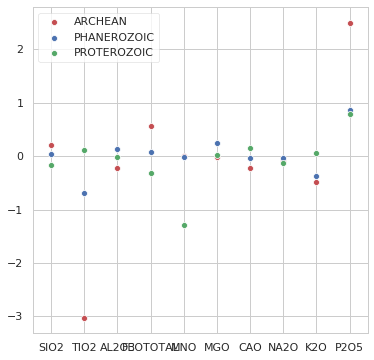

In [59]:
f, ax = plt.subplots(figsize=(6, 6))

sns.set_color_codes("deep")
sns.scatterplot(x=X.columns, y=svc_major.coef_[0], label=svc_major.classes_[0], color="r")
sns.scatterplot(x=X.columns, y=svc_major.coef_[1], label=svc_major.classes_[1], color="b")
sns.scatterplot(x=X.columns, y=svc_major.coef_[2], label=svc_major.classes_[2], color="g")

So let me take notes without reference to the previous and then compare:
* SiO2 - out of order, Prot lowest
* TiO2 - out of order, Prot highest
* Al2O3 - bounces around between regressions
* FeO - out of order, Prot lowest, Arch highest
* MnO - out of order, Prot much lower
* MgO - increases with time
* CaO - out of order, Prot highest
* Na2O - little effect, Prot lowest
* K2O - out of order, Prot highest
* P2O5 - decreasing with time, ish, Arch highest by a lot second time around

From logistic regression:

SiO2: moves toward mafic from PreC to Phan
TiO2: increases markedly over time
Al2O3: increases markedly in Phan
FeO: decreases markedly in Phan
MnO: decreases over time
MgO: out of order, lowest in Proterozoic
CaO: increases over time
Na2O: out of order, highest in Proterozoic
K2O: much lower in Archean
P2O5: out of order, much the lowest in Proterozoic, highest in Archean

What looks most like a match:
* Al2O3
* FeO, ish
* K2O, ish

But that was wrong.

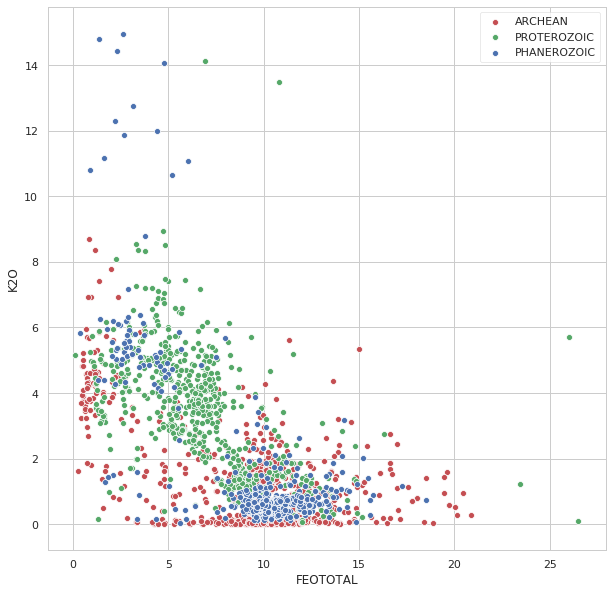

In [60]:
# K2O and FeO actually are important
f, ax = plt.subplots(figsize=(10, 10))

sns.set_color_codes("deep")
sns.scatterplot(x='FEOTOTAL', y='K2O', data=major_df[major_df['EON']=='ARCHEAN'],
                label='ARCHEAN', color="r")
sns.scatterplot(x='FEOTOTAL', y='K2O', data=major_df[major_df['EON']=='PROTEROZOIC'],
                label='PROTEROZOIC', color="g")
sns.scatterplot(x='FEOTOTAL', y='K2O', data=major_df[major_df['EON']=='PHANEROZOIC'],
                label='PHANEROZOIC', color="b")

In [61]:
rfc_major.feature_importances_

array([0.12320667, 0.13174445, 0.05910207, 0.11555238, 0.0649704 ,
       0.08656008, 0.09452627, 0.08363302, 0.14808583, 0.09261883])

In [62]:
rfc_imp = dict(zip(X.columns,rfc_major.feature_importances_))
rfc_imp

{'SIO2': 0.12320666945336273,
 'TIO2': 0.1317444468076533,
 'AL2O3': 0.05910206949569442,
 'FEOTOTAL': 0.1155523774079066,
 'MNO': 0.06497039722089816,
 'MGO': 0.08656008193449356,
 'CAO': 0.09452627264892205,
 'NA2O': 0.08363301898062905,
 'K2O': 0.14808583422101568,
 'P2O5': 0.0926188318294246}

In [63]:
gbf_imp = dict(zip(X.columns,gbf_major.feature_importances_))
gbf_imp

{'SIO2': 0.16805363437702112,
 'TIO2': 0.0881594744562142,
 'AL2O3': 0.022516223342663663,
 'FEOTOTAL': 0.14882588839306152,
 'MNO': 0.05770973275926704,
 'MGO': 0.08829028776323018,
 'CAO': 0.02654647984289311,
 'NA2O': 0.07596147920083797,
 'K2O': 0.23178111709814217,
 'P2O5': 0.09215568276666894}

Oh those are different. Hrm.
* Random Forest top (three): K2O, TiO2, SiO2, FeO was tied last time, lower this time
* Gradient Boost top three: K2O, SiO2/FeO tied last time, still close.

Looks like that calls for more plots:
K2O / FeO / SiO2
K2O / TiO2 / SiO2
K2O / TiO2 / FeO

In [65]:
trace0 = go.Scatter3d(
    x = major_df[major_df['EON']=='ARCHEAN']['SIO2'],
    y = major_df[major_df['EON']=='ARCHEAN']['K2O'],
    z = major_df[major_df['EON']=='ARCHEAN']['FEOTOTAL'],
    name = 'Archean',
    mode = 'markers',
    marker = dict(
        size=3,
        color='red',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace1 = go.Scatter3d(
    x = major_df[major_df['EON']=='PROTEROZOIC']['SIO2'],
    y = major_df[major_df['EON']=='PROTEROZOIC']['K2O'],
    z = major_df[major_df['EON']=='PROTEROZOIC']['FEOTOTAL'],
    name = 'Proterozoic',
    mode = 'markers',
    marker = dict(
        size=3,
        color='green',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace2 = go.Scatter3d(
    x = major_df[major_df['EON']=='PHANEROZOIC']['SIO2'],
    y = major_df[major_df['EON']=='PHANEROZOIC']['K2O'],
    z = major_df[major_df['EON']=='PHANEROZOIC']['FEOTOTAL'],
    name = 'Phanerozoic',
    mode = 'markers',
    marker = dict(
        size=3,
        color='blue',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

data=[trace0, trace1, trace2]

# Modify layout
layout = go.Layout(
    title = 'Major element chemistry by eon, S. Afr. igneous',
    scene =
      dict(
          xaxis = dict(
              title = 'SiO2',
              zeroline = True
          ),
          yaxis = dict(
              title = 'K2O',
              zeroline = True
          ),
          zaxis = dict(
              title = 'FeO (total)',
              zeroline = True
          ),
          hovermode= 'closest'
      )
)

off.iplot(dict(data=data, layout=layout))

In [66]:
trace0 = go.Scatter3d(
    x = major_df[major_df['EON']=='ARCHEAN']['TIO2'],
    y = major_df[major_df['EON']=='ARCHEAN']['K2O'],
    z = major_df[major_df['EON']=='ARCHEAN']['FEOTOTAL'],
    name = 'Archean',
    mode = 'markers',
    marker = dict(
        size=3,
        color='red',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace1 = go.Scatter3d(
    x = major_df[major_df['EON']=='PROTEROZOIC']['TIO2'],
    y = major_df[major_df['EON']=='PROTEROZOIC']['K2O'],
    z = major_df[major_df['EON']=='PROTEROZOIC']['FEOTOTAL'],
    name = 'Proterozoic',
    mode = 'markers',
    marker = dict(
        size=3,
        color='green',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace2 = go.Scatter3d(
    x = major_df[major_df['EON']=='PHANEROZOIC']['TIO2'],
    y = major_df[major_df['EON']=='PHANEROZOIC']['K2O'],
    z = major_df[major_df['EON']=='PHANEROZOIC']['FEOTOTAL'],
    name = 'Phanerozoic',
    mode = 'markers',
    marker = dict(
        size=3,
        color='blue',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

data=[trace0, trace1, trace2]

# Modify layout
layout = go.Layout(
    title = 'Major element chemistry by eon, S. Afr. igneous',
    scene =
      dict(
          xaxis = dict(
              title = 'TiO2',
              zeroline = True
          ),
          yaxis = dict(
              title = 'K2O',
              zeroline = True
          ),
          zaxis = dict(
              title = 'FeO (total)',
              zeroline = True
          ),
          hovermode= 'closest'
      )
)

off.iplot(dict(data=data, layout=layout))

In [67]:
trace0 = go.Scatter3d(
    x = major_df[major_df['EON']=='ARCHEAN']['SIO2'],
    y = major_df[major_df['EON']=='ARCHEAN']['K2O'],
    z = major_df[major_df['EON']=='ARCHEAN']['TIO2'],
    name = 'Archean',
    mode = 'markers',
    marker = dict(
        size=3,
        color='red',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace1 = go.Scatter3d(
    x = major_df[major_df['EON']=='PROTEROZOIC']['SIO2'],
    y = major_df[major_df['EON']=='PROTEROZOIC']['K2O'],
    z = major_df[major_df['EON']=='PROTEROZOIC']['TIO2'],
    name = 'Proterozoic',
    mode = 'markers',
    marker = dict(
        size=3,
        color='green',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

trace2 = go.Scatter3d(
    x = major_df[major_df['EON']=='PHANEROZOIC']['SIO2'],
    y = major_df[major_df['EON']=='PHANEROZOIC']['K2O'],
    z = major_df[major_df['EON']=='PHANEROZOIC']['TIO2'],
    name = 'Phanerozoic',
    mode = 'markers',
    marker = dict(
        size=3,
        color='blue',
        symbol='circle',
        opacity=0.5,
        line=dict(width=1)
     ),
    text=major_df['EON']
)

data=[trace0, trace1, trace2]

# Modify layout
layout = go.Layout(
    title = 'Major element chemistry by eon, S. Afr. igneous',
    scene =
      dict(
          xaxis = dict(
              title = 'SiO2',
              zeroline = True
          ),
          yaxis = dict(
              title = 'K2O',
              zeroline = True
          ),
          zaxis = dict(
              title = 'TiO2',
              zeroline = True
          ),
          hovermode= 'closest'
      )
)

off.iplot(dict(data=data, layout=layout))

All right, I haven't left myself a ton of time to fight through the REE data.

In [69]:
ree_df = df.dropna(subset=['LA'])

In [70]:
ree_only = ree_df[['LA','CE','PR','ND','SM','EU','GD','TB','DY','HO','ER','TM','YB','LU']].astype(float)
ree_eons = ree_df['EON']
ree_data = pd.concat([ree_eons,ree_only],axis=1)

In [71]:
ree_data.fillna(value=0.0,inplace=True)

In [72]:
LU_LA = np.divide(np.array(ree_only['LU']),np.array(ree_only['LA']))

In [73]:
EU_SM = np.divide(np.array(ree_only['EU']),np.array(ree_only['SM']))

/home/paulus/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:1: RuntimeWarning:

invalid value encountered in true_divide



In [74]:
ree_data['LU/LA']=LU_LA
ree_data['EU/SM']=EU_SM

In [75]:
ree_data.dtypes

EON       object
LA       float64
CE       float64
PR       float64
ND       float64
SM       float64
EU       float64
GD       float64
TB       float64
DY       float64
HO       float64
ER       float64
TM       float64
YB       float64
LU       float64
LU/LA    float64
EU/SM    float64
dtype: object

In [76]:
ree_data.dropna(inplace=True)
ree_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 865 entries, 49 to 2928
Data columns (total 17 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   EON     865 non-null    object 
 1   LA      865 non-null    float64
 2   CE      865 non-null    float64
 3   PR      865 non-null    float64
 4   ND      865 non-null    float64
 5   SM      865 non-null    float64
 6   EU      865 non-null    float64
 7   GD      865 non-null    float64
 8   TB      865 non-null    float64
 9   DY      865 non-null    float64
 10  HO      865 non-null    float64
 11  ER      865 non-null    float64
 12  TM      865 non-null    float64
 13  YB      865 non-null    float64
 14  LU      865 non-null    float64
 15  LU/LA   865 non-null    float64
 16  EU/SM   865 non-null    float64
dtypes: float64(16), object(1)
memory usage: 121.6+ KB


In [77]:
X_train,X_test,y_train,y_test=train_test_split(ree_data.drop(['EON'],axis=1)
                                               ,ree_data['EON'])

In [78]:
X,yo = ree_data.drop(['EON'],axis=1), ree_data['EON']

Mean SVC score:  0.7063583815028902
Individual scores:  [0.54913295 0.67052023 0.87861272 0.84393064 0.58959538]

Train:  0.8611111111111112  Test:  0.7972350230414746


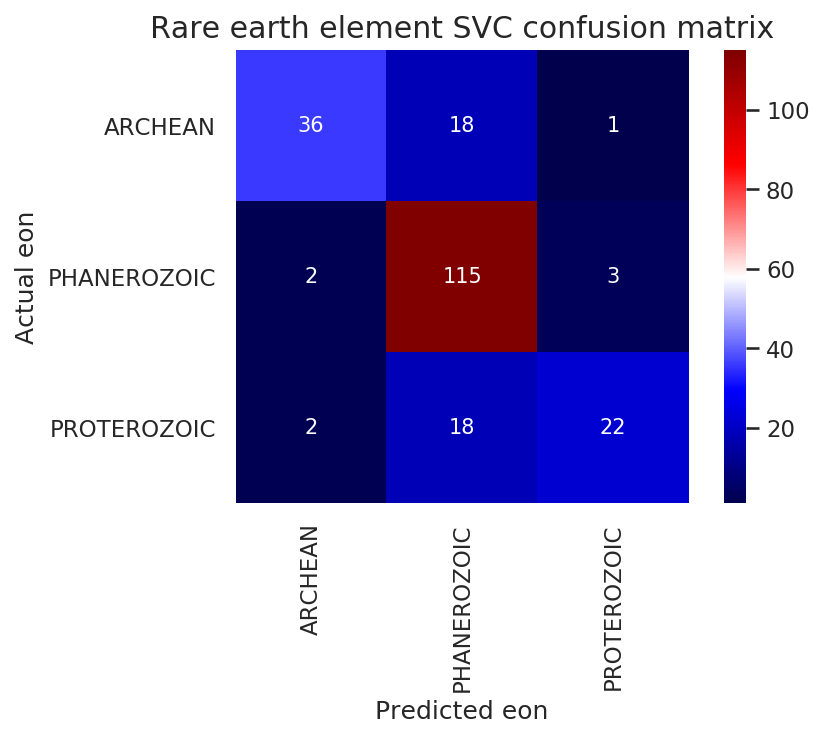

In [79]:
ree_svc = SVC(kernel='linear')
ree_svc_scores = cross_val_score(ree_svc,X,yo)
print("Mean SVC score: ",np.mean(ree_svc_scores))
print("Individual scores: ",ree_svc_scores)
ree_svc.fit(X_train,y_train)
print("\nTrain: ",ree_svc.score(X_train,y_train)," Test: ",ree_svc.score(X_test,y_test))
ree_svc_confusion = confusion_matrix(y_test, ree_svc.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(ree_svc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=ree_svc.classes_,
           yticklabels=ree_svc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Rare earth element SVC confusion matrix');

In [80]:
print(len(ree_svc.support_vectors_),"support vectors: ", ree_svc.support_vectors_)
print(len(ree_svc.dual_coef_),"coefficients: ", ree_svc.dual_coef_)
print("intercept: ", ree_svc.intercept_)

303 support vectors:  [[ 3.65       10.3         1.56       ...  0.23        0.0630137
   0.32352941]
 [ 1.08        2.5         0.         ...  0.1         0.09259259
   0.43835616]
 [13.02       29.71        4.06       ...  0.27        0.02073733
   0.29146919]
 ...
 [21.1        41.1         0.         ...  0.24        0.01137441
   0.26541555]
 [33.9        57.          0.         ...  0.09        0.00265487
   0.34191176]
 [36.2        54.2         0.         ...  0.05        0.00138122
   0.47727273]]
2 coefficients:  [[ 1.          1.          1.          1.          1.          1.
   1.          1.          1.          1.          1.          1.
   1.          1.          1.          1.          1.          1.
   0.          0.          0.18828684  0.          1.          1.
   1.          1.          0.          1.          1.          1.
   1.          1.          1.          1.          1.          1.
   1.          1.          1.          1.          0.          0.58129722


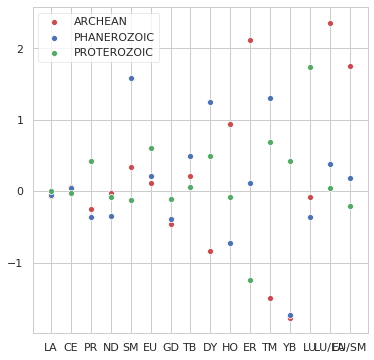

In [81]:
f, ax = plt.subplots(figsize=(6, 6))
sns.set_color_codes("deep")
sns.scatterplot(x=X.columns, y=ree_svc.coef_[0], label=ree_svc.classes_[0], color="r")
sns.scatterplot(x=X.columns, y=ree_svc.coef_[1], label=ree_svc.classes_[1], color="b")
sns.scatterplot(x=X.columns, y=ree_svc.coef_[2], label=ree_svc.classes_[2], color="g")

Mean RFC score:  0.8520231213872831
Individual scores:  [0.79768786 0.89017341 0.93641618 0.93063584 0.70520231]

Train:  1.0  Test:  0.9078341013824884


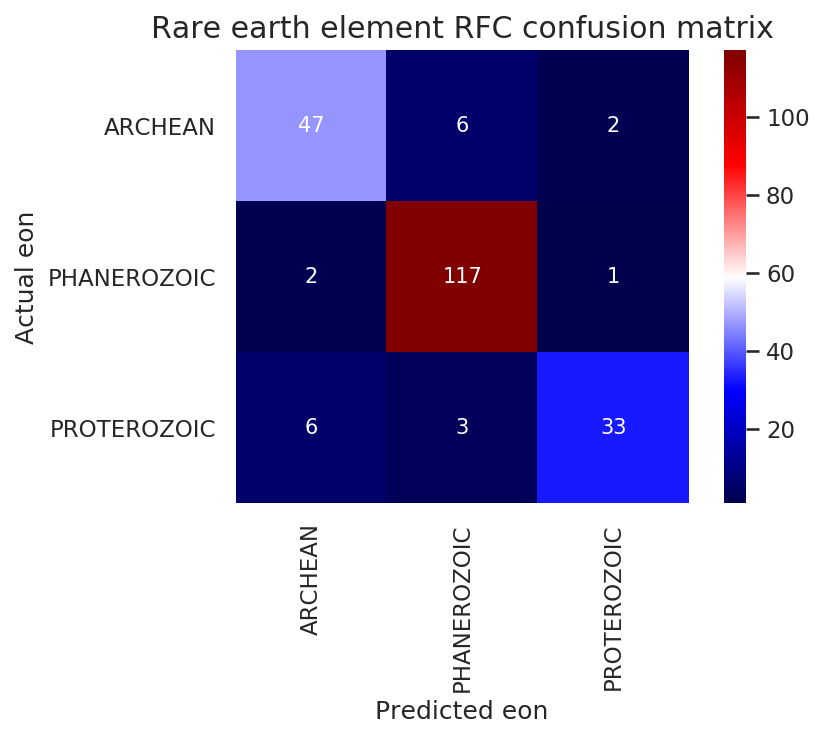

In [82]:
ree_rfc = RandomForestClassifier()
ree_rfc_scores = cross_val_score(ree_rfc,X,yo)
print("Mean RFC score: ",np.mean(ree_rfc_scores))
print("Individual scores: ",ree_rfc_scores)
ree_rfc.fit(X_train,y_train)
print("\nTrain: ",ree_rfc.score(X_train,y_train)," Test: ",ree_rfc.score(X_test,y_test))
ree_rfc_confusion = confusion_matrix(y_test, ree_rfc.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(ree_rfc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=ree_rfc.classes_,
           yticklabels=ree_rfc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Rare earth element RFC confusion matrix');

In [83]:
ree_rfc_imp = dict(zip(X.columns,ree_rfc.feature_importances_))
ree_rfc_imp

{'LA': 0.06801542308730266,
 'CE': 0.06233645253534219,
 'PR': 0.11817204026181317,
 'ND': 0.13381121919858585,
 'SM': 0.047220607335768036,
 'EU': 0.04428972022710495,
 'GD': 0.0643461836985487,
 'TB': 0.03251670351266378,
 'DY': 0.08793813286521707,
 'HO': 0.030593790089377883,
 'ER': 0.06385629497549941,
 'TM': 0.04523388382052845,
 'YB': 0.037115764446593355,
 'LU': 0.04045162818703452,
 'LU/LA': 0.08602185612832583,
 'EU/SM': 0.03808029963029403}

Mean GBF score:  0.8265895953757226
Individual scores:  [0.76300578 0.82080925 0.93063584 0.91907514 0.69942197]

Train:  1.0  Test:  0.8894009216589862


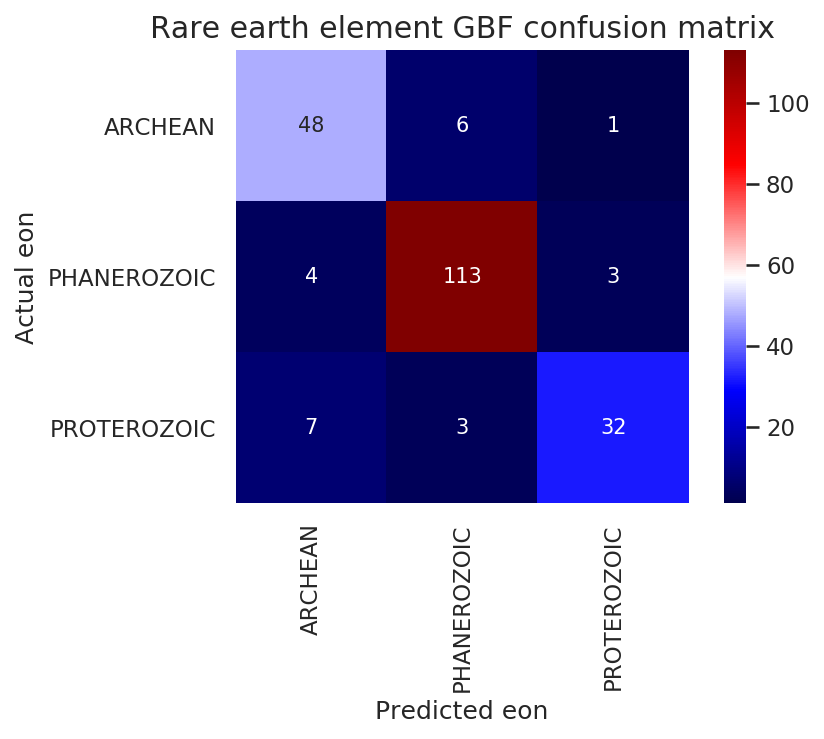

In [84]:
ree_gbf = GradientBoostingClassifier()
ree_gbf_scores = cross_val_score(ree_gbf,X,yo)
print("Mean GBF score: ",np.mean(ree_gbf_scores))
print("Individual scores: ",ree_gbf_scores)
ree_gbf.fit(X_train,y_train)
print("\nTrain: ",ree_gbf.score(X_train,y_train)," Test: ",ree_gbf.score(X_test,y_test))
ree_gbf_confusion = confusion_matrix(y_test, ree_gbf.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(ree_gbf_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=ree_gbf.classes_,
           yticklabels=ree_gbf.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Rare earth element GBF confusion matrix');

In [85]:
ree_gbf_imp = dict(zip(X.columns,ree_gbf.feature_importances_))
ree_gbf_imp

{'LA': 0.02620734922384646,
 'CE': 0.021155197973804527,
 'PR': 0.20262940323128675,
 'ND': 0.20373099393902805,
 'SM': 0.014411825292891672,
 'EU': 0.029315490210286843,
 'GD': 0.041067531441947164,
 'TB': 0.02212501515374702,
 'DY': 0.02055871986998394,
 'HO': 0.06464418182566938,
 'ER': 0.04360219946817803,
 'TM': 0.050669827117845304,
 'YB': 0.018566958624409297,
 'LU': 0.03577193127649533,
 'LU/LA': 0.16694043821269908,
 'EU/SM': 0.03860293713788116}

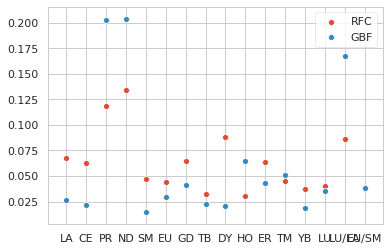

In [86]:
sns.scatterplot(x=X.columns,y=ree_rfc.feature_importances_,label='RFC')
sns.scatterplot(x=X.columns,y=ree_gbf.feature_importances_,label='GBF')

Praseodymium and neodymium being clearly the most important features is in no way anything that I expected.

Once I cleared out the duplicated ratio La/Lu, Lu/La turns out to be an important feature in the forest models. I'm surprised the europium anomaly ratio is not.

Right, then. Major element ratios:
* Mg# = Mg/(Mg+Fe)
* Calc-alkali = Ca/(Na+K)
* Fe/Mn
* Si/Al
* Si/Ti

In [87]:
ratios_df = pd.concat([major_df['EON'],
                      major_df['MGO']/(major_df['MGO']+major_df['FEOTOTAL'])*100,
                      major_df['CAO']/(major_df['NA2O']+major_df['K2O']),
                      major_df['FEOTOTAL']/major_df['MNO'],
                      major_df['SIO2']/major_df['AL2O3'],
                      major_df['SIO2']/major_df['TIO2']],axis=1)
ratios_df.columns = ['Eon','Mg#','Ca/Alk','Fe/Mn','Si/Al','Si/Ti']

In [88]:
ratios_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2180 entries, 0 to 2998
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Eon     2180 non-null   object 
 1   Mg#     2063 non-null   float64
 2   Ca/Alk  2168 non-null   float64
 3   Fe/Mn   2017 non-null   float64
 4   Si/Al   2178 non-null   float64
 5   Si/Ti   2176 non-null   float64
dtypes: float64(5), object(1)
memory usage: 119.2+ KB


In [89]:
ratios_df.replace(to_replace=np.inf,value=np.nan,inplace=True)
ratios_df.dropna(inplace=True)
ratios_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1963 entries, 0 to 2998
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Eon     1963 non-null   object 
 1   Mg#     1963 non-null   float64
 2   Ca/Alk  1963 non-null   float64
 3   Fe/Mn   1963 non-null   float64
 4   Si/Al   1963 non-null   float64
 5   Si/Ti   1963 non-null   float64
dtypes: float64(5), object(1)
memory usage: 107.4+ KB


In [90]:
X_train,X_test,y_train,y_test = train_test_split(ratios_df.drop(['Eon'],axis=1),
                                                 ratios_df['Eon'])
X,yo = ratios_df.drop(['Eon'],axis=1),ratios_df['Eon']

Mean SVC score:  0.6821480500597186
Individual scores:  [0.5394402  0.6870229  0.76335878 0.74744898 0.67346939]

Train:  0.7112771739130435  Test:  0.670061099796334


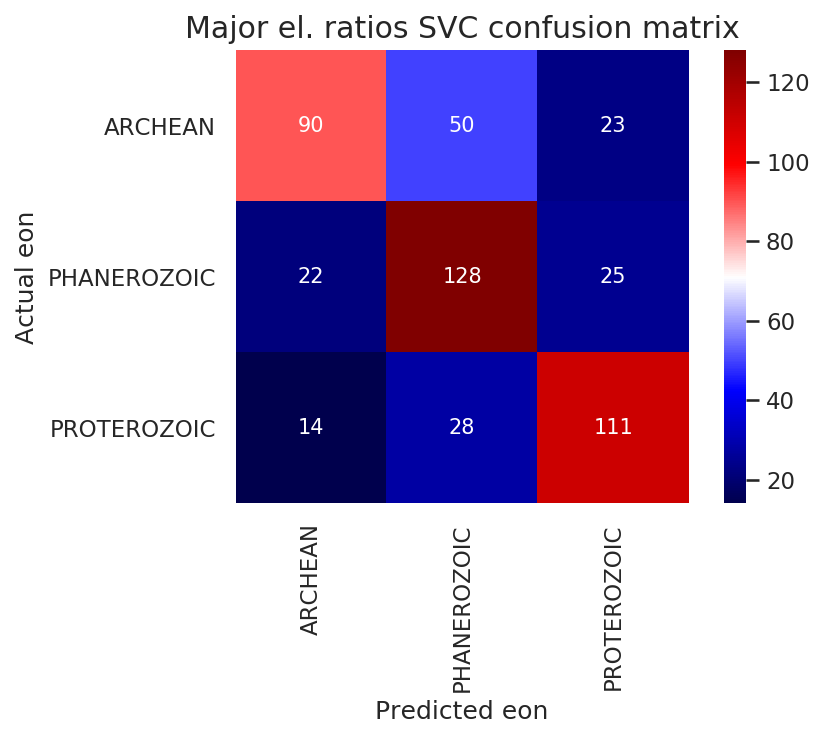

In [91]:
ratio_svc = SVC(kernel='linear')
ratio_svc_scores = cross_val_score(ratio_svc,X,yo)
print("Mean SVC score: ",np.mean(ratio_svc_scores))
print("Individual scores: ",ratio_svc_scores)
ratio_svc.fit(X_train,y_train)
print("\nTrain: ",ratio_svc.score(X_train,y_train)," Test: ",ratio_svc.score(X_test,y_test))
ratio_svc_confusion = confusion_matrix(y_test, ratio_svc.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(ratio_svc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=ratio_svc.classes_,
           yticklabels=ratio_svc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major el. ratios SVC confusion matrix');

In [92]:
print(len(ratio_svc.support_vectors_),"support vectors: ", ratio_svc.support_vectors_)
print(len(ratio_svc.dual_coef_),"coefficients: ", ratio_svc.dual_coef_)
print("intercept: ", ratio_svc.intercept_)

980 support vectors:  [[ 34.92961066   2.35149864  58.42055983   3.22797203  49.10638298]
 [ 31.86836988   3.93023256  61.51343228   3.48559671  50.82      ]
 [ 26.05923576   1.47706422  61.5718204    3.45305875  47.90756303]
 ...
 [ 31.0240369    2.46556474  57.80598594   3.90545455  55.9375    ]
 [ 39.2033543    0.4646098   41.42857143   6.9213691  267.21428571]
 [ 51.62045351   0.67013889  23.3132632    5.17683398 117.61403509]]
2 coefficients:  [[ 1.  1.  1. ... -1. -1. -1.]
 [ 1.  1.  1. ... -1. -0. -0.]]
intercept:  [-7.79410483 -1.18489177  0.38676781]


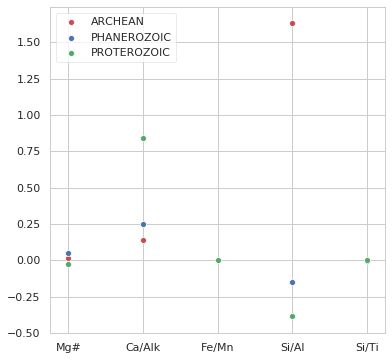

In [93]:
f, ax = plt.subplots(figsize=(6, 6))
sns.set_color_codes("deep")
sns.scatterplot(x=X.columns, y=ratio_svc.coef_[0], label=ratio_svc.classes_[0], color="r")
sns.scatterplot(x=X.columns, y=ratio_svc.coef_[1], label=ratio_svc.classes_[1], color="b")
sns.scatterplot(x=X.columns, y=ratio_svc.coef_[2], label=ratio_svc.classes_[2], color="g")

Mean RFC score:  0.801330684945734
Individual scores:  [0.66412214 0.81424936 0.91348601 0.875      0.73979592]

Train:  1.0  Test:  0.8655804480651731


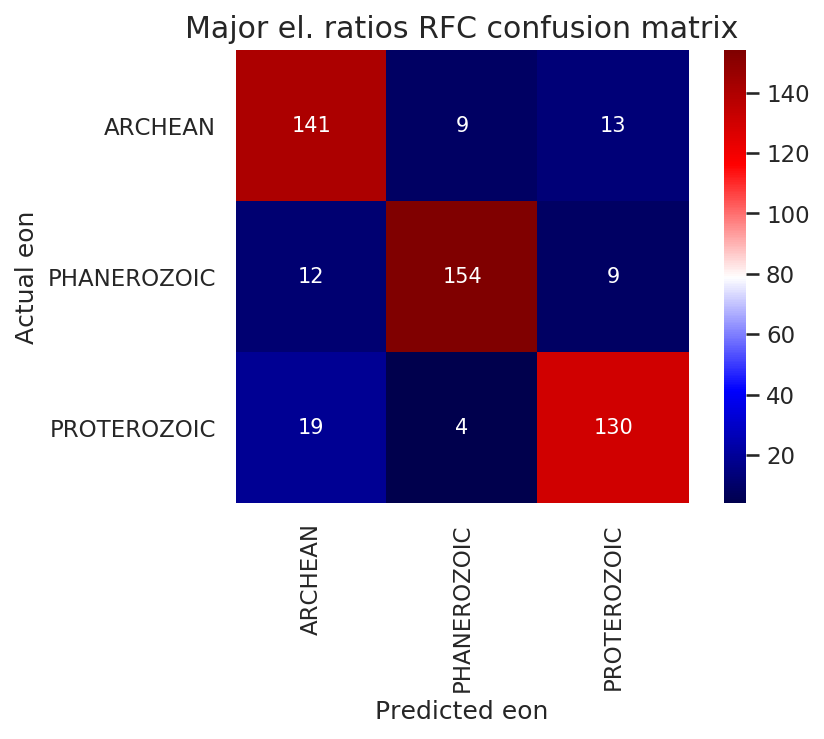

In [94]:
ratio_rfc = RandomForestClassifier()
ratio_rfc_scores = cross_val_score(ratio_rfc,X,yo)
print("Mean RFC score: ",np.mean(ratio_rfc_scores))
print("Individual scores: ",ratio_rfc_scores)
ratio_rfc.fit(X_train,y_train)
print("\nTrain: ",ratio_rfc.score(X_train,y_train)," Test: ",ratio_rfc.score(X_test,y_test))
ratio_rfc_confusion = confusion_matrix(y_test, ratio_rfc.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(ratio_rfc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=ratio_rfc.classes_,
           yticklabels=ratio_rfc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major el. ratios RFC confusion matrix');

In [95]:
ratio_rfc_imp = dict(zip(X.columns,ratio_rfc.feature_importances_))
ratio_rfc_imp

{'Mg#': 0.21236472102157072,
 'Ca/Alk': 0.214318635344639,
 'Fe/Mn': 0.09092147405212339,
 'Si/Al': 0.2416268640968109,
 'Si/Ti': 0.24076830548485598}

Mean GBF score:  0.8028483148984785
Individual scores:  [0.67175573 0.82697201 0.91857506 0.85969388 0.7372449 ]

Train:  0.951766304347826  Test:  0.8655804480651731


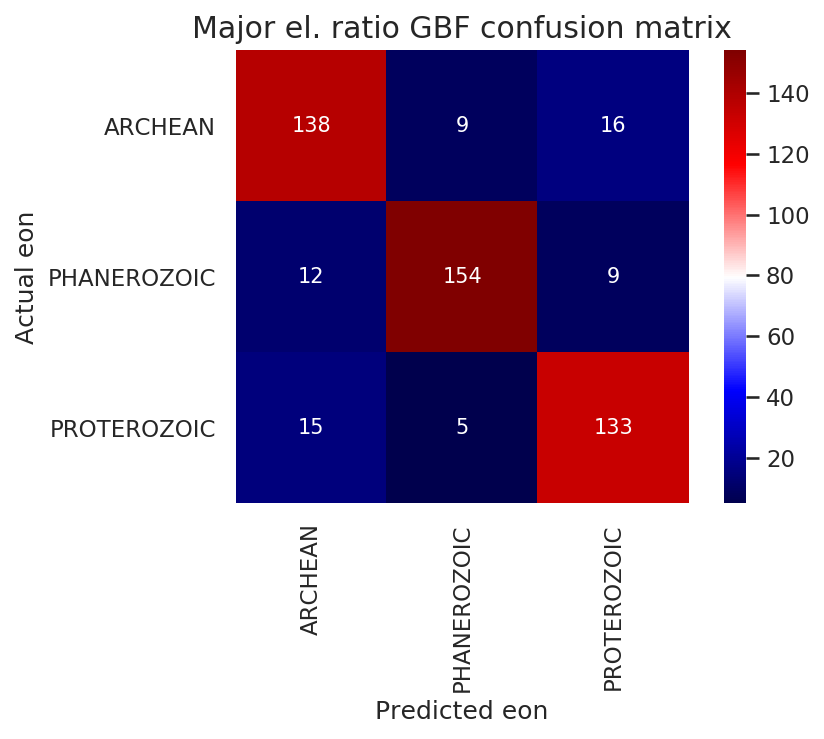

In [96]:
ratio_gbf = GradientBoostingClassifier()
ratio_gbf_scores = cross_val_score(ratio_gbf,X,yo)
print("Mean GBF score: ",np.mean(ratio_gbf_scores))
print("Individual scores: ",ratio_gbf_scores)
ratio_gbf.fit(X_train,y_train)
print("\nTrain: ",ratio_gbf.score(X_train,y_train)," Test: ",ratio_gbf.score(X_test,y_test))
ratio_gbf_confusion = confusion_matrix(y_test, ratio_gbf.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(ratio_gbf_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=ratio_gbf.classes_,
           yticklabels=ratio_gbf.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major el. ratio GBF confusion matrix');

In [97]:
ratio_gbf_imp = dict(zip(X.columns,ratio_gbf.feature_importances_))
ratio_gbf_imp

{'Mg#': 0.17330372063127572,
 'Ca/Alk': 0.2939325211456889,
 'Fe/Mn': 0.05011196793973026,
 'Si/Al': 0.2598563183388193,
 'Si/Ti': 0.22279547194448598}

Might continue feature engineering by dropping Fe/Mn and replacing it with something that focuses more on K, or P, or do some more thinking. Would be important to see if nearly all the accuracy in the all-major-element classifiers can be recovered by a suite of only 5 to 7 ratios.

Then, if one wanted to get really fancy-dancy, one could throw in Pr, Nd, Lu/La.

Also, worth going back and
* standardizing the variables
* using a logistic regression with lasso / elastic net to eliminate features.

F it. Let's do that first. Here we go. Hang on tight.

In [99]:
grand_df = major_df[['EON','SIO2','TIO2','AL2O3','FEOTOTAL','MNO','MGO','CAO',
          'NA2O','K2O','P2O5',
          'LA','CE','PR','ND','SM','EU','GD','TB','DY','HO','ER','TM','YB','LU']].copy()

In [101]:
rat_df = pd.concat([major_df['MGO']/(major_df['MGO']+major_df['FEOTOTAL'])*100,
                      major_df['CAO']/(major_df['NA2O']+major_df['K2O']),
                      major_df['FEOTOTAL']/major_df['MNO'],
                      major_df['SIO2']/major_df['AL2O3'],
                      major_df['SIO2']/major_df['TIO2']],axis=1)
rat_df.columns = ['Mg#','Ca/Alk','Fe/Mn','Si/Al','Si/Ti']
grand_df = pd.concat([grand_df,rat_df],axis=1)
grand_df.columns

Index(['EON', 'SIO2', 'TIO2', 'AL2O3', 'FEOTOTAL', 'MNO', 'MGO', 'CAO', 'NA2O',
       'K2O', 'P2O5', 'LA', 'CE', 'PR', 'ND', 'SM', 'EU', 'GD', 'TB', 'DY',
       'HO', 'ER', 'TM', 'YB', 'LU', 'Mg#', 'Ca/Alk', 'Fe/Mn', 'Si/Al',
       'Si/Ti'],
      dtype='object')

In [102]:
rrat_df = pd.concat([major_df['LU']/major_df['LA'],major_df['EU']/major_df['SM']],axis=1)
rrat_df.columns = ['LU/LA','EU/SM']

In [103]:
grand_df = pd.concat([grand_df,rrat_df],axis=1)
grand_df.columns

Index(['EON', 'SIO2', 'TIO2', 'AL2O3', 'FEOTOTAL', 'MNO', 'MGO', 'CAO', 'NA2O',
       'K2O', 'P2O5', 'LA', 'CE', 'PR', 'ND', 'SM', 'EU', 'GD', 'TB', 'DY',
       'HO', 'ER', 'TM', 'YB', 'LU', 'Mg#', 'Ca/Alk', 'Fe/Mn', 'Si/Al',
       'Si/Ti', 'LU/LA', 'EU/SM'],
      dtype='object')

In [104]:
grand_df.replace(to_replace=np.inf,value=np.nan,inplace=True)
grand_df.dropna(inplace=True)
grand_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 417 entries, 127 to 2928
Data columns (total 32 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   EON       417 non-null    object 
 1   SIO2      417 non-null    float64
 2   TIO2      417 non-null    float64
 3   AL2O3     417 non-null    float64
 4   FEOTOTAL  417 non-null    float64
 5   MNO       417 non-null    float64
 6   MGO       417 non-null    float64
 7   CAO       417 non-null    float64
 8   NA2O      417 non-null    float64
 9   K2O       417 non-null    float64
 10  P2O5      417 non-null    float64
 11  LA        417 non-null    float64
 12  CE        417 non-null    float64
 13  PR        417 non-null    float64
 14  ND        417 non-null    float64
 15  SM        417 non-null    float64
 16  EU        417 non-null    float64
 17  GD        417 non-null    float64
 18  TB        417 non-null    float64
 19  DY        417 non-null    float64
 20  HO        417 non-null    flo

In [106]:
X=np.array(grand_df.drop(['EON'],axis=1))
y=grand_df['EON']

Hooo, not many data points left.
Let's do a straight lasso and try to knock out everything we can.

"The ‘newton-cg’, ‘sag’ and ‘lbfgs’ solvers support only l2 penalties. ‘elasticnet’ is only supported by the ‘saga’ solver."

    solver{‘newton-cg’, ‘lbfgs’, ‘liblinear’, ‘sag’, ‘saga’}, default=’lbfgs’

Algorithm to use in the optimization problem.

For small datasets, ‘liblinear’ is a good choice, whereas ‘sag’ and ‘saga’ are faster for large ones.

For multiclass problems, only ‘newton-cg’, ‘sag’, ‘saga’ and ‘lbfgs’ handle multinomial loss; ‘liblinear’ is limited to one-versus-rest schemes.

‘newton-cg’, ‘lbfgs’, ‘sag’ and ‘saga’ handle L2 or no penalty

‘liblinear’ and ‘saga’ also handle L1 penalty

‘saga’ also supports ‘elasticnet’ penalty

‘liblinear’ does not support setting penalty='none'

Note that ‘sag’ and ‘saga’ fast convergence is only guaranteed on features with approximately the same scale. You can preprocess the data with a scaler from sklearn.preprocessing.

In [108]:
scaler = MinMaxScaler()
X_tr,X_tst,y_tr,y_tst = train_test_split(X,y)
X_scale = scaler.fit_transform(X_tr)
X_tstsc = scaler.transform(X_tst)

In [109]:
grand_loge = LogisticRegression(penalty='l1',C=0.5,solver='liblinear')

Mean cross-validation score:  0.8827022375215148
Individual scores:  [0.77380952 0.9047619  0.92771084 0.92771084 0.87951807]

Train:  0.8237179487179487  Test:  0.8380952380952381


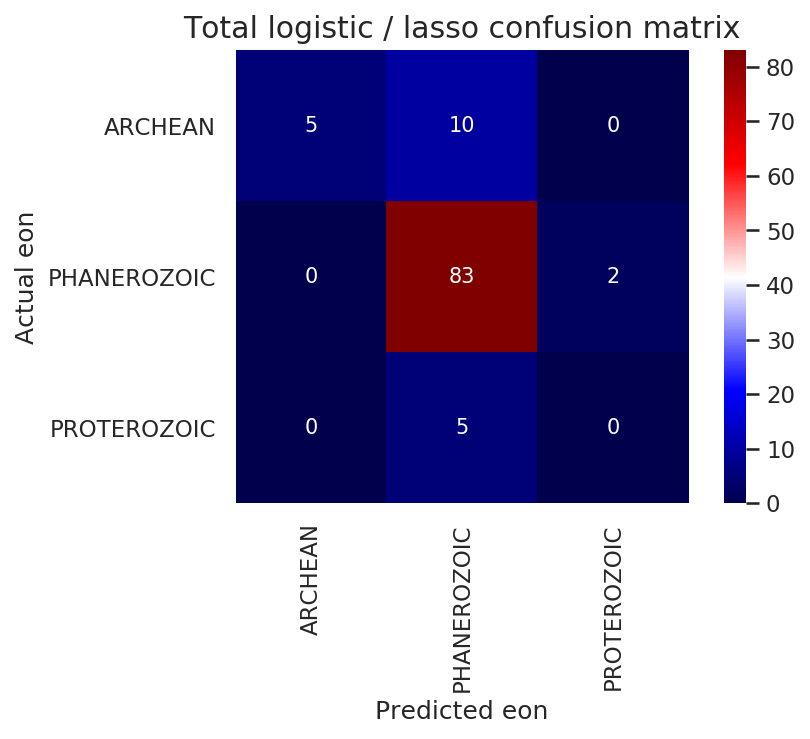

In [112]:
grand_loge_scores = cross_val_score(grand_loge,X,y)
print("Mean cross-validation score: ",np.mean(grand_loge_scores))
print("Individual scores: ",grand_loge_scores)
grand_loge.fit(X_scale,y_tr)
print("\nTrain: ",grand_loge.score(X_scale,y_tr)," Test: ",
      grand_loge.score(X_tstsc,y_tst))
grand_loge_confusion = confusion_matrix(y_tst, grand_loge.predict(X_tstsc))
plt.figure(dpi=150)
sns.heatmap(grand_loge_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=grand_loge.classes_,
           yticklabels=grand_loge.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Total logistic / lasso confusion matrix');

Ok, so that can't be done... not enough coverage.

The only "major" element not in the ratios already is P2O5. Let's dump FeO/MnO and either use raw P2O5 or SiO2/P2O5. We'll stick with a ratio.

In [114]:
Si_P = major_df['SIO2']/major_df['P2O5']
rat_df = pd.concat([major_df['EON'],rat_df,Si_P],axis=1)
rat_df.columns = ['EON','Mg#','Ca/Alk','Fe/Mn','Si/Al','Si/Ti','Si/P']

In [115]:
del rat_df['Fe/Mn']

In [116]:
rat_df.replace(to_replace=np.inf,value=np.nan,inplace=True)
rat_df.dropna(inplace=True)
rat_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 2004 entries, 0 to 2998
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   EON     2004 non-null   object 
 1   Mg#     2004 non-null   float64
 2   Ca/Alk  2004 non-null   float64
 3   Si/Al   2004 non-null   float64
 4   Si/Ti   2004 non-null   float64
 5   Si/P    2004 non-null   float64
dtypes: float64(5), object(1)
memory usage: 109.6+ KB


In [117]:
X_train,X_test,y_train,y_test = train_test_split(rat_df.drop(['EON'],axis=1),
                                                 rat_df['EON'])
X,yo = rat_df.drop(['EON'],axis=1),rat_df['EON']

In [ ]:
rat_svc = SVC(kernel='linear')
rat_svc_scores = cross_val_score(rat_svc,X,yo)
print("Mean SVC score: ",np.mean(rat_svc_scores))
print("Individual scores: ",rat_svc_scores)
rat_svc.fit(X_train,y_train)
print("\nTrain: ",rat_svc.score(X_train,y_train)," Test: ",rat_svc.score(X_test,y_test))
rat_svc_confusion = confusion_matrix(y_test, rat_svc.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(rat_svc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=rat_svc.classes_,
           yticklabels=rat_svc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major el. rats SVC confusion matrix');

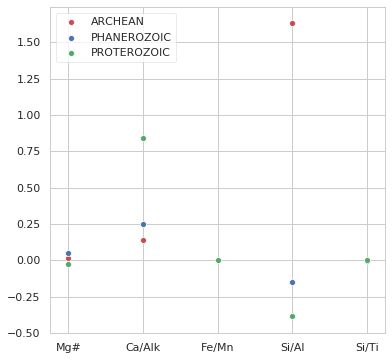

In [93]:
f, ax = plt.subplots(figsize=(6, 6))
sns.set_color_codes("deep")
sns.scatterplot(x=X.columns, y=rat_svc.coef_[0], label=rat_svc.classes_[0], color="r")
sns.scatterplot(x=X.columns, y=rat_svc.coef_[1], label=rat_svc.classes_[1], color="b")
sns.scatterplot(x=X.columns, y=rat_svc.coef_[2], label=rat_svc.classes_[2], color="g")

In [ ]:
rat_rfc = RandomForestClassifier()
rat_rfc_scores = cross_val_score(rat_rfc,X,yo)
print("Mean RFC score: ",np.mean(rat_rfc_scores))
print("Individual scores: ",rat_rfc_scores)
rat_rfc.fit(X_train,y_train)
print("\nTrain: ",rat_rfc.score(X_train,y_train)," Test: ",rat_rfc.score(X_test,y_test))
rat_rfc_confusion = confusion_matrix(y_test, rat_rfc.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(rat_rfc_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=rat_rfc.classes_,
           yticklabels=rat_rfc.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major el. rats RFC confusion matrix');

In [95]:
rat_rfc_imp = dict(zip(X.columns,rat_rfc.feature_importances_))
rat_rfc_imp

{'Mg#': 0.21236472102157072,
 'Ca/Alk': 0.214318635344639,
 'Fe/Mn': 0.09092147405212339,
 'Si/Al': 0.2416268640968109,
 'Si/Ti': 0.24076830548485598}

Mean GBF score:  0.8028483148984785
Individual scores:  [0.67175573 0.82697201 0.91857506 0.85969388 0.7372449 ]

Train:  0.951766304347826  Test:  0.8655804480651731


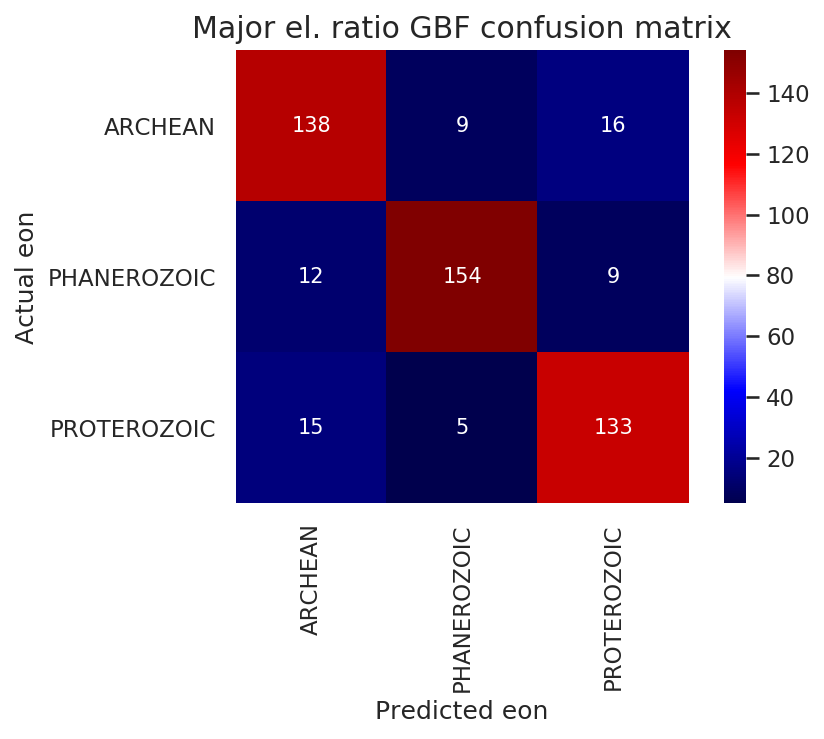

In [96]:
rat_gbf = GradientBoostingClassifier()
rat_gbf_scores = cross_val_score(rat_gbf,X,yo)
print("Mean GBF score: ",np.mean(rat_gbf_scores))
print("Individual scores: ",rat_gbf_scores)
rat_gbf.fit(X_train,y_train)
print("\nTrain: ",rat_gbf.score(X_train,y_train)," Test: ",rat_gbf.score(X_test,y_test))
rat_gbf_confusion = confusion_matrix(y_test, rat_gbf.predict(X_test))
plt.figure(dpi=150)
sns.heatmap(rat_gbf_confusion, cmap=plt.cm.seismic, annot=True, square=True,
           xticklabels=rat_gbf.classes_,
           yticklabels=rat_gbf.classes_,
           fmt=".0f")
plt.xlabel('Predicted eon')
plt.ylabel('Actual eon')
plt.title('Major el. rat GBF confusion matrix');

In [97]:
rat_gbf_imp = dict(zip(X.columns,rat_gbf.feature_importances_))
rat_gbf_imp

{'Mg#': 0.17330372063127572,
 'Ca/Alk': 0.2939325211456889,
 'Fe/Mn': 0.05011196793973026,
 'Si/Al': 0.2598563183388193,
 'Si/Ti': 0.22279547194448598}